In [1]:
# https://pypi.tuna.tsinghua.edu.cn/simple
import anndata as ad
import scanpy as sc
import squidpy as sq
import cellcharter as cc
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/torchvision/io/image.py:13: UserWarning: Failed to load image Python extension: /home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/torchvision/image.so: undefined symbol: _ZN3c1017RegisterOperatorsD1Ev
  warn(f"Failed to load image Python extension: {e}")


In [2]:
data_list = ["./RNA/B924-1.expr.bin_100.h5", "./RNA/B926-1.expr.bin_100.h5", "./RNA/B922-1.expr.bin_100.h5",
             "./RNA/B924-2.expr.bin_100.h5", "./RNA/B926-2.expr.bin_100.h5", "./RNA/B922-2.expr.bin_100.h5"]
marker = ["1-1", "2-1", "3-1", "1-2", "2-2", "3-2"]

In [3]:
anndata_list = []
for idx, data in enumerate(data_list):
    anndata_ = sc.read_h5ad(data)
    anndata_.obs["marker"] = marker[idx]
    anndata_list.append(anndata_)

In [4]:
combined_data = ad.concat(anndata_list)
combined_data.obs_names_make_unique()

/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [5]:
rnadata = combined_data.copy()

In [6]:
rnadata.var["mt"] = rnadata.var_names.str.startswith("Mt")
rnadata.var["mt-"] = rnadata.var_names.str.startswith("mt-")
rnadata.var["gm"] = rnadata.var_names.str.startswith("Gm")
rnadata.var["Rb"] = rnadata.var_names.str.startswith("Rp")
rnadata.var["rik"] = [True if "Rik" in str else False for str in rnadata.var_names]
fdata = rnadata[:, ~rnadata.var["mt"]].copy()
fdata = fdata[:, ~fdata.var["mt-"]]
fdata = fdata[:, ~fdata.var["Rb"]]
fdata = fdata[:, ~fdata.var["gm"]]
fdata = fdata[:, ~fdata.var["rik"]]

In [7]:
fdata.var_names

Index(['A1cf', 'A2m', 'A3galt2', 'A4galt', 'AA467197', 'AA543186', 'AA792892',
       'AA986860', 'AB124611', 'AC061963.1',
       ...
       'Zwilch', 'Zwint', 'Zxdb', 'Zxdc', 'Zyg11a', 'Zyg11b', 'Zyx', 'Zzef1',
       'Zzz3', 'a'],
      dtype='object', length=15867)

In [8]:
with open("./He2020Nature_mouseHK.txt", 'r') as f:
    for line in f:
        hk_genes = line.split('\t')
        break
fdata = fdata[:, [gene for gene in fdata.var_names if gene not in hk_genes]]
sc.pp.filter_cells(fdata, min_genes=3)
sc.pp.filter_cells(fdata, min_counts=3)
fdata

/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/scanpy/preprocessing/_simple.py:160: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["n_genes"] = number


AnnData object with n_obs × n_vars = 118279 × 13177
    obs: 'marker', 'n_genes', 'n_counts'
    var: 'mt', 'mt-', 'gm', 'Rb', 'rik'
    obsm: 'spatial'

# guide data

In [6]:
data_list = ["./RNA/B924-1.guide.bin_100.h5", "./RNA/B926-1.guide.bin_100.h5", "./RNA/B922-1.guide.bin_100.h5",
             "./RNA/B924-2.guide.bin_100.h5", "./RNA/B926-2.guide.bin_100.h5", "./RNA/B922-2.guide.bin_100.h5"]
marker = ["1-1", "2-1", "3-1", "1-2", "2-2", "3-2"]

In [12]:
anndata_list = []
for idx, data in enumerate(data_list):
    anndata_ = sc.read_h5ad(data)
    anndata_.obs["marker"] = marker[idx]
    anndata_list.append(anndata_)

In [13]:
guide_data = ad.concat(anndata_list)
guide_data.obs_names_make_unique()

/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [14]:
count_df = pd.DataFrame(guide_data.X.toarray(), columns=guide_data.var_names.tolist())

In [15]:
count_df["marker"] = guide_data.obs["marker"].tolist()

In [67]:
count_df

,sgAdrb2_1_gene,sgAdrb2_2_gene,sgAqp3_1_gene,sgAqp3_2_gene,sgArntl_1_gene,sgArntl_2_gene,sgCd44_1_gene,sgCd44_2_gene,sgCd52_1_gene,sgCd52_2_gene,...,sgTmem64_2_gene,sgWipf1_1_gene,sgWipf1_2_gene,sgZc3h12a_1_gene,sgZc3h12a_2_gene,sgZhx2_1_gene,sgZhx2_2_gene,sgZscan12_1_gene,sgZscan12_2_gene,marker
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1-1
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1-1
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,1-1
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1-1
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
114670,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,3-2
114671,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,3-2
114672,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,3-2
114673,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,3-2


UFuncTypeError: ufunc 'add' did not contain a loop with signature matching types (dtype('<U1'), dtype('<U1')) -> None

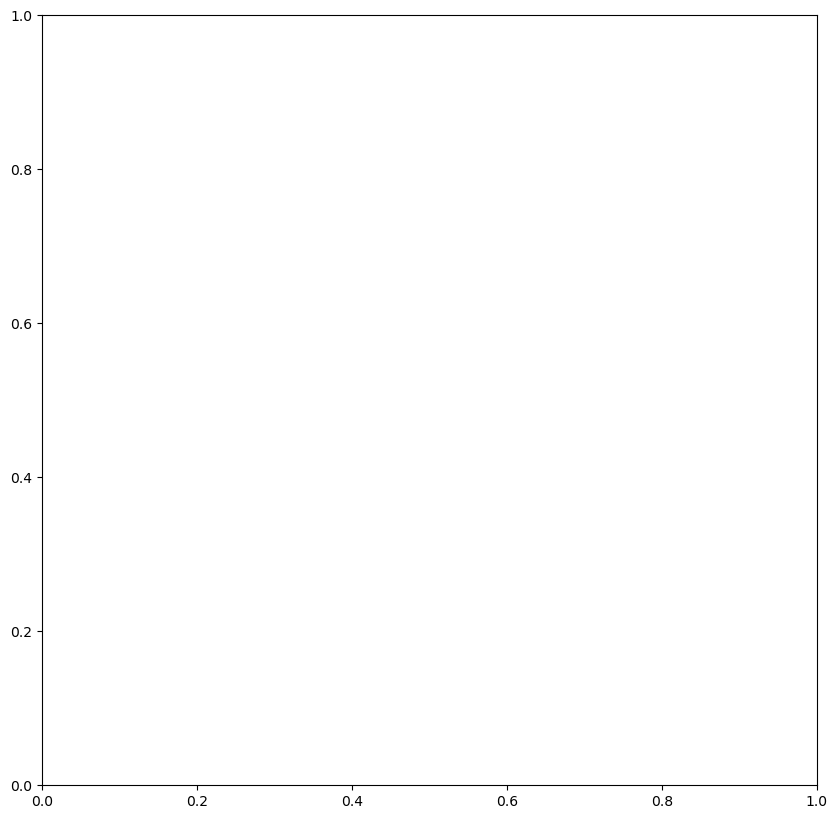

In [21]:
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
for marker in np.unique(count_df["marker"]):
    sub_df = count_df[count_df["marker"] == marker].iloc[:, :-1]

In [39]:
sg_genes = [gene for gene in adata.var_names if gene.startswith('sg')]
sgdata = adata[:, sg_genes].copy()
sgdata

AnnData object with n_obs × n_vars = 66577 × 66
    obs: 'time_point'
    obsm: 'spatial'

In [46]:
sgdata.write_h5ad("./gRNA/Multitime.grna.h5")

In [1]:
import torch

In [3]:
torch.cuda.is_available()

False

In [47]:
fdata.layers["counts"] = fdata.X.copy()
sc.pp.normalize_total(fdata)
sc.pp.log1p(fdata)

In [48]:
fdata

AnnData object with n_obs × n_vars = 66509 × 16001
    obs: 'time_point', 'n_genes', 'n_counts'
    var: 'mt', 'mt-', 'gm', 'Rb', 'rik'
    uns: 'log1p'
    obsm: 'spatial'
    layers: 'counts'

In [49]:
fdata.write_h5ad("./RNA/Multitime.filtered.rna.h5")

In [50]:
fdata = ad.read_h5ad("./RNA/Multitime.filtered.rna.h5")

In [51]:
fdata

AnnData object with n_obs × n_vars = 66509 × 16001
    obs: 'time_point', 'n_genes', 'n_counts'
    var: 'mt', 'mt-', 'gm', 'Rb', 'rik'
    uns: 'log1p'
    obsm: 'spatial'
    layers: 'counts'

# SCVI clustering

In [9]:
import scvi

Global seed set to 0


In [10]:
model = scvi.model.SCVI.load("/home/wpy/stereoseq/20240502-SPACseq/scripts/scvi.model/")

INFO     File /home/wpy/stereoseq/20240502-SPACseq/scripts/scvi.model/model.pt already downloaded                  


/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/anndata/__init__.py:55: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(
/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/abc.py:119: FutureWarning: SparseDataset is deprecated and will be removed in late 2024. It has been replaced by the public classes CSRDataset and CSCDataset.

For instance checks, use `isinstance(X, (anndata.experimental.CSRDataset, anndata.experimental.CSCDataset))` instead.

For creation, use `anndata.experimental.sparse_dataset(X)` instead.

  return _abc_instancecheck(cls, instance)


In [11]:
fdata.obsm["X_scVI"] = model.get_latent_representation(fdata).astype(np.float32)

INFO     Input AnnData not setup with scvi-tools. attempting to transfer AnnData setup                             


/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/abc.py:119: FutureWarning: SparseDataset is deprecated and will be removed in late 2024. It has been replaced by the public classes CSRDataset and CSCDataset.

For instance checks, use `isinstance(X, (anndata.experimental.CSRDataset, anndata.experimental.CSCDataset))` instead.

For creation, use `anndata.experimental.sparse_dataset(X)` instead.

  return _abc_instancecheck(cls, instance)


In [12]:
fdata.obs["marker"] = fdata.obs["marker"].astype("category")

In [13]:
fdata.obs.dtypes

marker          category
n_genes            int64
n_counts           int64
_scvi_batch         int8
_scvi_labels        int8
dtype: object

In [14]:
sq.gr.spatial_neighbors(fdata, library_key="marker", coord_type="generic", delaunay=True, spatial_key="spatial")

In [15]:
cc.gr.remove_long_links(fdata)

In [16]:
fdata

AnnData object with n_obs × n_vars = 118279 × 13177
    obs: 'marker', 'n_genes', 'n_counts', '_scvi_batch', '_scvi_labels'
    var: 'mt', 'mt-', 'gm', 'Rb', 'rik'
    uns: '_scvi_uuid', '_scvi_manager_uuid', 'spatial_neighbors'
    obsm: 'spatial', 'X_scVI'
    obsp: 'spatial_connectivities', 'spatial_distances'

In [17]:
cc.gr.aggregate_neighbors(fdata, n_layers=3, use_rep="X_scVI", out_key="X_cellcharter", sample_key="time_point")

100%|██████████| 4/4 [00:00<00:00,  5.23it/s]


In [65]:
autok = cc.tl.ClusterAutoK(
    n_clusters = (7,20),
    max_runs = 10,
    model_params = dict(
        random_state = 114514
    )
)

In [66]:
autok.fit(fdata, use_rep="X_cellcharter")

Iteration 1/10


  0%|          | 0/16 [00:00<?, ?it/s]/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/lightning_fabric/plugins/environments/slurm.py:165: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/wpy/miniconda3/envs/cellcharter/lib/python3.10 ...
  rank_zero_warn(
  6%|▋         | 1/16 [00:31<07:54, 31.61s/it]/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/lightning_fabric/plugins/environments/slurm.py:165: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/wpy/miniconda3/envs/cellcharter/lib/python3.10 ...
  rank_zero_warn(
 12%|█▎        | 2/16 [00:54<06:08, 26.33s/it]/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/lightning_fabri

Iteration 2/10


  0%|          | 0/16 [00:00<?, ?it/s]/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/lightning_fabric/plugins/environments/slurm.py:165: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/wpy/miniconda3/envs/cellcharter/lib/python3.10 ...
  rank_zero_warn(
  6%|▋         | 1/16 [00:26<06:31, 26.10s/it]/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/lightning_fabric/plugins/environments/slurm.py:165: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/wpy/miniconda3/envs/cellcharter/lib/python3.10 ...
  rank_zero_warn(
 12%|█▎        | 2/16 [00:47<05:29, 23.56s/it]/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/lightning_fabri

Iteration 3/10


  0%|          | 0/16 [00:00<?, ?it/s]/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/lightning_fabric/plugins/environments/slurm.py:165: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/wpy/miniconda3/envs/cellcharter/lib/python3.10 ...
  rank_zero_warn(
  6%|▋         | 1/16 [00:26<06:41, 26.78s/it]/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/lightning_fabric/plugins/environments/slurm.py:165: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/wpy/miniconda3/envs/cellcharter/lib/python3.10 ...
  rank_zero_warn(
 12%|█▎        | 2/16 [00:48<05:34, 23.90s/it]/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/lightning_fabri

Iteration 4/10


  0%|          | 0/16 [00:00<?, ?it/s]/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/lightning_fabric/plugins/environments/slurm.py:165: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/wpy/miniconda3/envs/cellcharter/lib/python3.10 ...
  rank_zero_warn(
  6%|▋         | 1/16 [00:22<05:39, 22.66s/it]/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/lightning_fabric/plugins/environments/slurm.py:165: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/wpy/miniconda3/envs/cellcharter/lib/python3.10 ...
  rank_zero_warn(
 12%|█▎        | 2/16 [00:43<05:01, 21.52s/it]/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/lightning_fabri

Iteration 5/10


  0%|          | 0/16 [00:00<?, ?it/s]/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/lightning_fabric/plugins/environments/slurm.py:165: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/wpy/miniconda3/envs/cellcharter/lib/python3.10 ...
  rank_zero_warn(
  6%|▋         | 1/16 [00:21<05:16, 21.07s/it]/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/lightning_fabric/plugins/environments/slurm.py:165: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/wpy/miniconda3/envs/cellcharter/lib/python3.10 ...
  rank_zero_warn(
 12%|█▎        | 2/16 [00:38<04:25, 18.98s/it]/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/lightning_fabri

Iteration 6/10


  0%|          | 0/16 [00:00<?, ?it/s]/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/lightning_fabric/plugins/environments/slurm.py:165: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/wpy/miniconda3/envs/cellcharter/lib/python3.10 ...
  rank_zero_warn(
  6%|▋         | 1/16 [00:17<04:26, 17.74s/it]/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/lightning_fabric/plugins/environments/slurm.py:165: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/wpy/miniconda3/envs/cellcharter/lib/python3.10 ...
  rank_zero_warn(
 12%|█▎        | 2/16 [00:37<04:26, 19.01s/it]/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/lightning_fabri

Iteration 7/10


  0%|          | 0/16 [00:00<?, ?it/s]/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/lightning_fabric/plugins/environments/slurm.py:165: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/wpy/miniconda3/envs/cellcharter/lib/python3.10 ...
  rank_zero_warn(
  6%|▋         | 1/16 [00:30<07:36, 30.41s/it]/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/lightning_fabric/plugins/environments/slurm.py:165: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/wpy/miniconda3/envs/cellcharter/lib/python3.10 ...
  rank_zero_warn(
 12%|█▎        | 2/16 [00:53<06:03, 25.96s/it]/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/lightning_fabri

Iteration 8/10


  0%|          | 0/16 [00:00<?, ?it/s]/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/lightning_fabric/plugins/environments/slurm.py:165: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/wpy/miniconda3/envs/cellcharter/lib/python3.10 ...
  rank_zero_warn(
  6%|▋         | 1/16 [00:22<05:34, 22.28s/it]/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/lightning_fabric/plugins/environments/slurm.py:165: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/wpy/miniconda3/envs/cellcharter/lib/python3.10 ...
  rank_zero_warn(
 12%|█▎        | 2/16 [00:40<04:40, 20.02s/it]/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/lightning_fabri

Iteration 9/10


  0%|          | 0/16 [00:00<?, ?it/s]/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/lightning_fabric/plugins/environments/slurm.py:165: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/wpy/miniconda3/envs/cellcharter/lib/python3.10 ...
  rank_zero_warn(
  6%|▋         | 1/16 [00:17<04:25, 17.70s/it]/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/lightning_fabric/plugins/environments/slurm.py:165: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/wpy/miniconda3/envs/cellcharter/lib/python3.10 ...
  rank_zero_warn(
 12%|█▎        | 2/16 [00:36<04:19, 18.53s/it]/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/lightning_fabri

Convergence with a change in stability of 0.007024051057799137 reached after 9 iterations


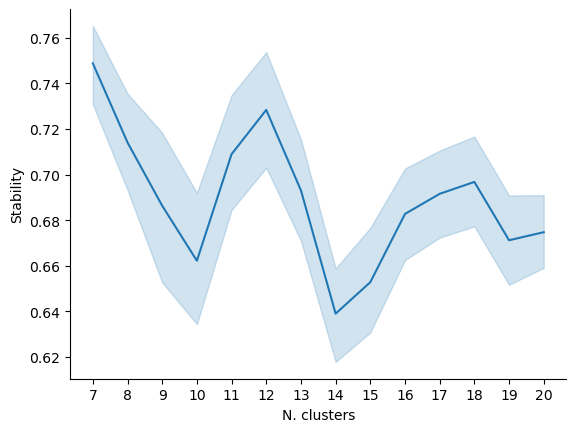

In [68]:
cc.pl.autok_stability(autok)

In [69]:
fdata.obs["cluster_cellcharter_autok"] = autok.predict(fdata, use_rep="X_cellcharter")

/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/lightning_fabric/plugins/environments/slurm.py:165: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/wpy/miniconda3/envs/cellcharter/lib/python3.10 ...
  rank_zero_warn(


/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/squidpy/pl/_spatial_utils.py:483: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = color_source_vector.map(color_map)
/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/squidpy/pl/_spatial_utils.py:483: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = color_source_vector.map(color_map)
/ho

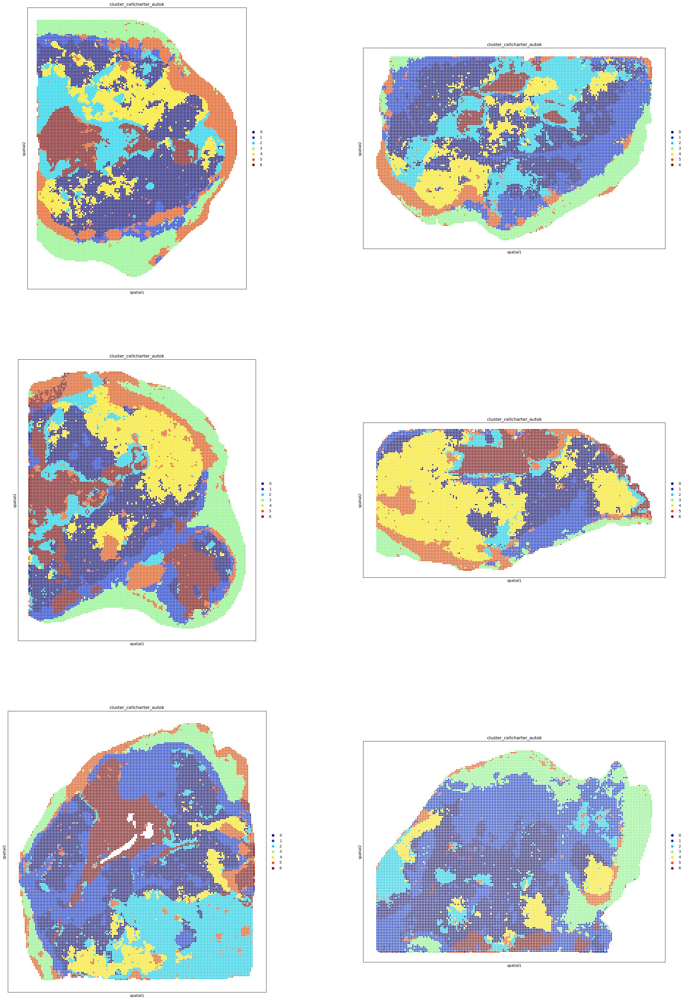

In [71]:
sq.pl.spatial_scatter(
    fdata, 
    color=['cluster_cellcharter_autok'], 
    library_key='marker',  
    size=20, 
    img=None,
    spatial_key='spatial',
    palette='jet',
    #connectivity_key='spatial_connectivities',
    #img_alpha=0.3,
    figsize=(15,15),
    ncols=2,
    shape=None
)

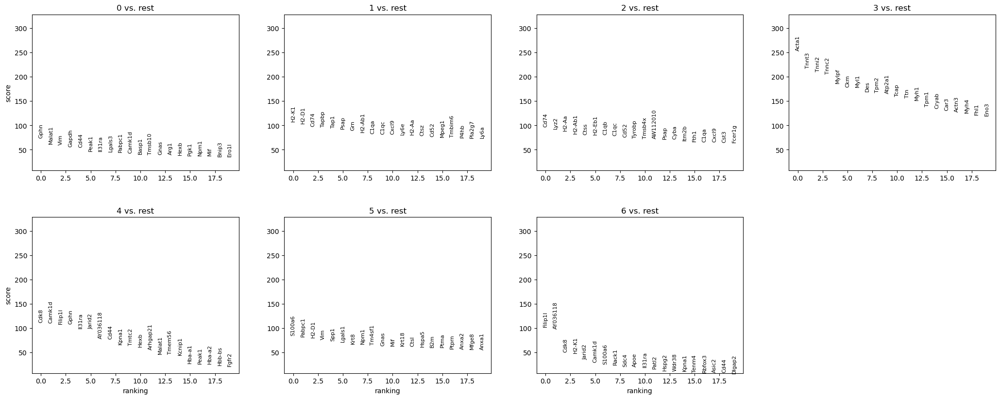

In [63]:
sc.tl.rank_genes_groups(fdata, groupby="cluster_cellcharter_autok", method="t-test")
sc.pl.rank_genes_groups(fdata, n_genes=20)

In [77]:
givenk = cc.tl.Cluster(
    n_clusters = 12,
)

In [78]:
givenk.fit(fdata, use_rep="X_cellcharter")

/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/lightning_fabric/plugins/environments/slurm.py:165: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/wpy/miniconda3/envs/cellcharter/lib/python3.10 ...
  rank_zero_warn(


In [79]:
fdata.obs["cluster_cellcharter_givenk"] = givenk.predict(fdata, use_rep="X_cellcharter")

/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/squidpy/pl/_spatial_utils.py:483: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = color_source_vector.map(color_map)
/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/wpy/miniconda3/envs/cellcharter/lib/python3.10/site-packages/squidpy/pl/_spatial_utils.py:483: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = color_source_vector.map(color_map)
/ho

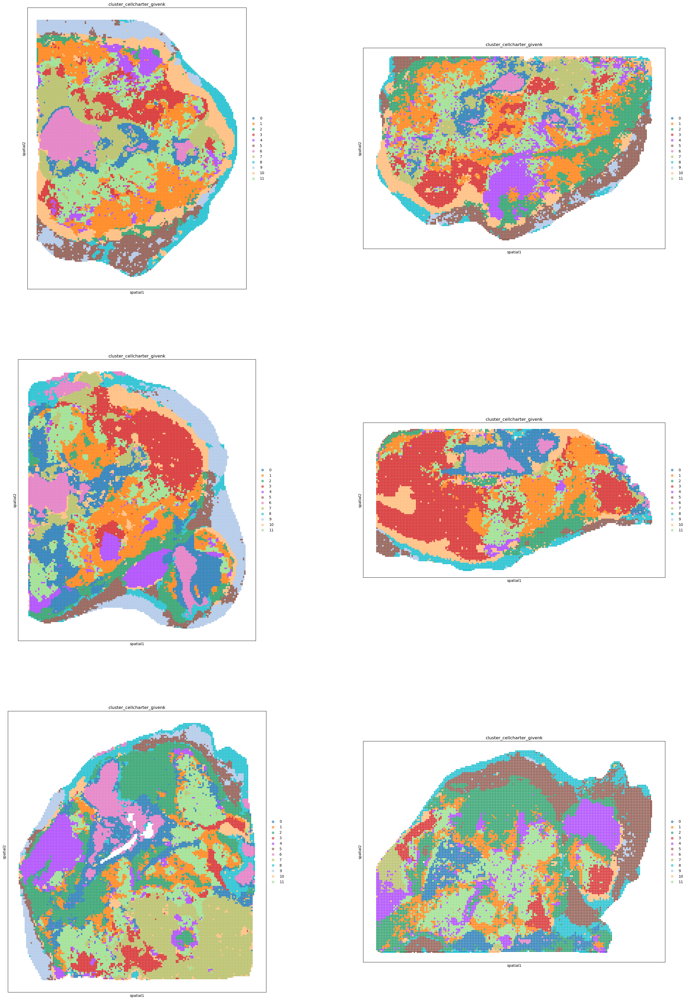

In [80]:
sq.pl.spatial_scatter(
    fdata, 
    color=['cluster_cellcharter_givenk'], 
    library_key='marker',  
    size=50, 
    img=None,
    spatial_key='spatial',
    cmap="Set1",
    #connectivity_key='spatial_connectivities',
    #img_alpha=0.3,
    figsize=(15,15),
    ncols=2,
    alpha=0.6,
    shape=None
)

In [23]:
fdata.layers["counts"] = fdata.X

In [24]:
sc.pp.log1p(fdata)
sc.pp.normalize_total(fdata)

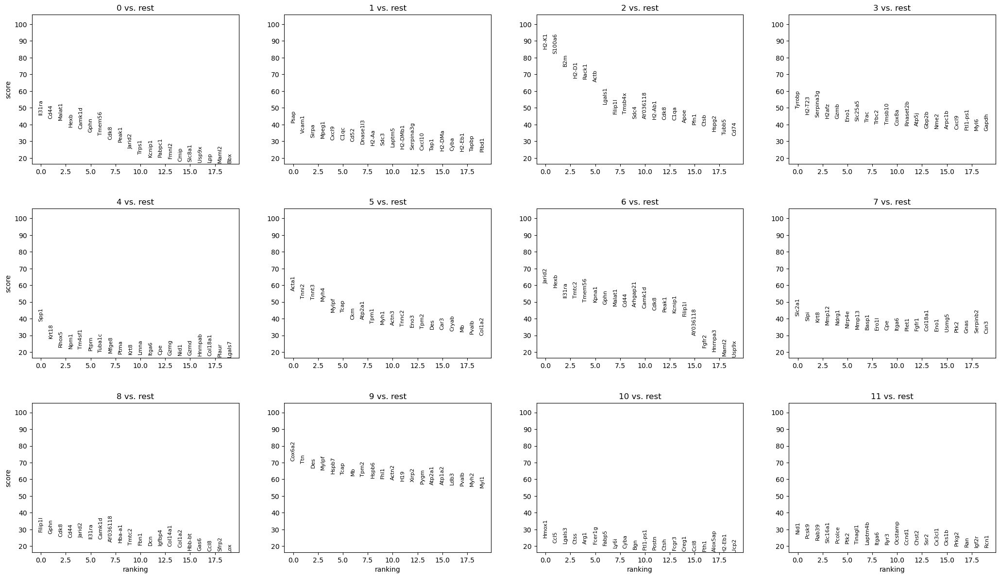

In [25]:
sc.tl.rank_genes_groups(fdata, groupby="cluster_cellcharter_givenk", method="t-test")
sc.pl.rank_genes_groups(fdata, n_genes=20)

In [91]:
fdata.write_h5ad("./RNA/Multitime.clustered.h5")

In [23]:
fdata = ad.read_h5ad("./RNA/Multitime.clustered.h5")

# Proportion

In [81]:
p_df = fdata.obs[["cluster_cellcharter_givenk", "marker"]].groupby("marker").value_counts().unstack()

/tmp/ipykernel_59395/3032623044.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  p_df = fdata.obs[["cluster_cellcharter_givenk", "marker"]].groupby("marker").value_counts().unstack()


In [56]:
import seaborn as sns

In [82]:
p_df

cluster_cellcharter_givenk,0,1,2,3,4,5,6,7,8,9,10,11
marker,,,,,,,,,,,,
1-1,880,3166,496,1697,1022,1488,1335,2208,1055,1461,2250,3479
1-2,935,3623,2448,1549,1882,1744,275,1696,536,395,1612,2711
2-1,3182,3370,1520,2794,1226,1075,1532,1142,1113,2406,1437,2258
2-2,1224,2268,850,4625,267,438,671,326,760,62,1584,1234
3-1,2375,1826,3812,1031,1746,709,1469,3670,1397,984,662,3230
3-2,1244,1944,3903,698,2021,3128,29,424,1309,73,374,2914


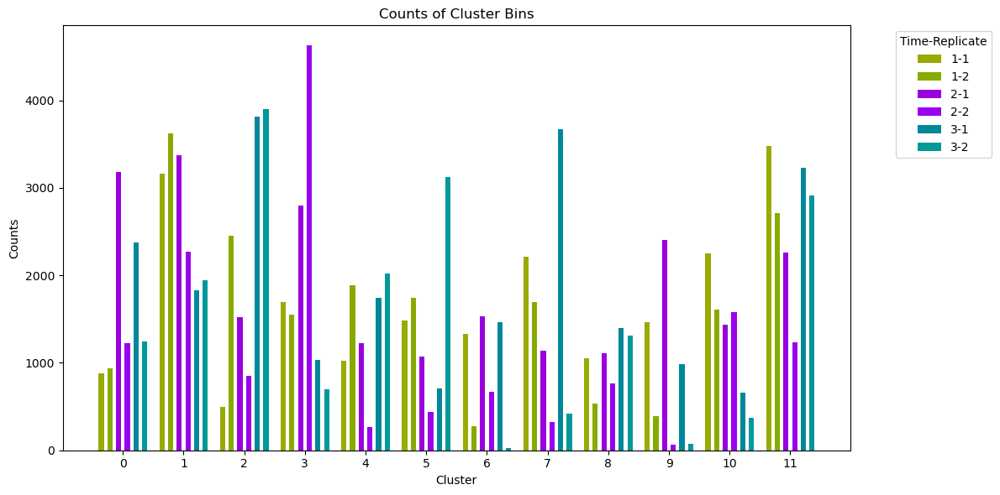

In [90]:
p_df_melted = p_df.reset_index().melt(id_vars='marker', var_name='Cluster', value_name='Expression')
p_df_melted.rename(columns={'index': 'marker'}, inplace=True)

# 设置绘图参数
bar_width = 0.6
clusters = p_df.columns.unique()
markers = p_df.index.unique()
cluster_gap = 1  # Cluster之间的间隔

# 计算每个Cluster在x轴上的位置
cluster_positions = []
for i, cluster in enumerate(clusters):
    start_position = i * (len(markers) + cluster_gap)
    cluster_positions.extend([start_position + j for j in range(len(markers))])

# 绘制条形图
plt.figure(figsize=(12, 6))

#colors = plt.cm.get_cmap('tab10', len(markers)).colors
colors = ["#99AA00", "#88AA00", "#9900DD", "#9900EE", "#008899", "#009999"]

for i, (marker, color) in enumerate(zip(markers, colors)):
    positions = [pos for pos, m in zip(cluster_positions, p_df_melted['marker']) if m == marker]
    values = p_df_melted[p_df_melted['marker'] == marker]['Expression']
    plt.bar(positions, values, bar_width, label=marker, color=color)

# 设置x轴标签
cluster_ticks = [pos + (len(markers) - 1) / 2 for pos in range(0, len(clusters) * (len(markers) + cluster_gap), len(markers) + cluster_gap)]
plt.xticks(cluster_ticks, clusters)

# 设置图例
plt.legend(title='Time-Replicate', bbox_to_anchor=(1.05, 1), loc='upper left')

# 设置标签和标题
plt.xlabel('Cluster')
plt.ylabel('Counts')
plt.title('Counts of Cluster Bins')

# 显示图表
plt.tight_layout()
plt.show()

# DEG

In [127]:
pval_cutoff = 0.01
top_n = 100

result = fdata.uns['rank_genes_groups']
groups = result['names'].dtype.names  # 获取所有聚类的名字

# 创建一个空的DataFrame用来存储结果
top_genes_df = pd.DataFrame()

for group in groups:
    # 提取每个聚类的基因名称、Log2FC、padj
    genes = result['names'][group]
    log2fc = result['logfoldchanges'][group]
    padj = result['pvals_adj'][group]
    
    # 将它们转换为DataFrame
    data = pd.DataFrame({
        'Gene': genes,
        'Log2FoldChange': log2fc,
        'padj': padj
    })
    
    # 筛选出padj > 0.01的基因
    filtered_data = data[data['padj'] < 0.01]
    #filtered_data = filtered_data[filtered_data['Log2FoldChange'] > 1]
    
    # 按Log2FoldChange降序排序
    sorted_data = filtered_data.sort_values(by='Log2FoldChange', ascending=False)
    
    # 选取排序前10的基因
    top_genes = sorted_data.head(top_n)
    #top_genes = sorted_data
    
    # 添加聚类信息
    top_genes['Cluster'] = group
    
    # 将当前聚类的结果追加到总的DataFrame中
    top_genes_df = pd.concat([top_genes_df, top_genes], ignore_index=True)

deg = top_genes_df["Gene"].unique().tolist()
top_genes_df.to_csv("./DEG.txt", index=None, sep="\t")

/tmp/ipykernel_61793/3698205361.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_genes['Cluster'] = group
/tmp/ipykernel_61793/3698205361.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_genes['Cluster'] = group
/tmp/ipykernel_61793/3698205361.py:35: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

In [120]:
len(deg)

1015

In [72]:
import gseapy as gp

In [81]:
[str for str in gp.get_library_name() if str.startswith("Reactome")]

['Reactome_2013', 'Reactome_2015', 'Reactome_2016', 'Reactome_2022']

In [73]:
top_genes_df

,Gene,Log2FoldChange,padj,Cluster
0,Ibsp,2.162694,1.232859e-12,0
1,Ntrk1,1.819355,4.985266e-03,0
2,Krt27,1.717725,8.860298e-08,0
3,Cdk5r2,1.586731,5.736048e-05,0
4,Aqp3,1.567521,8.125998e-71,0
...,...,...,...,...
595,Sox11,1.849898,1.348748e-10,11
596,Chrdl1,1.848060,1.337406e-06,11
597,Gpr88,1.839417,3.024034e-05,11
598,En1,1.838741,6.794028e-05,11


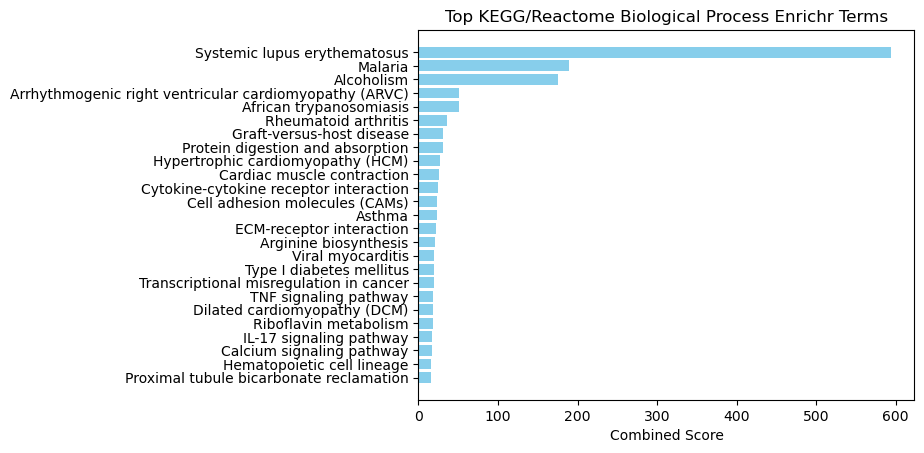

In [121]:
enr = gp.enrich(gene_list=deg,
                gene_sets=["KEGG_2019_Mouse"],
                background=None)
results = enr.results.sort_values(by='Combined Score', ascending=False).head(25)  # Select top 10 results for visualization
plt.barh(results['Term'], results['Combined Score'], color='skyblue')
plt.xlabel('Combined Score')
plt.title('Top KEGG/Reactome Biological Process Enrichr Terms')
plt.gca().invert_yaxis()  # Invert y-axis to have the highest score on top
plt.show()

In [128]:
degs = [[] for i in range(16)]
for i in range(13):
    degs[i] = top_genes_df.loc[top_genes_df["Cluster"] == str(i)]["Gene"]

In [129]:
enrs = {}
for i in range(13):
    enr = gp.enrich(gene_list=degs[i],
                gene_sets=["KEGG_2019_Mouse"],
                background=None)
    enrs[i] = enr.results

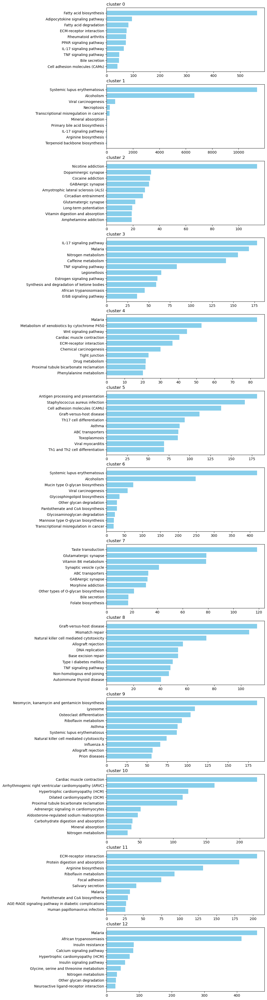

In [131]:
fig = plt.figure(figsize=(8, 50))
for i in range(13):
    ax = plt.subplot(13, 1, i+1)
    results = enrs[i].sort_values(by='Combined Score', ascending=False).head(10)  # Select top 10 results for visualization

    ax.barh(results['Term'], results['Combined Score'], color='skyblue')

    plt.title(f"cluster {i}", loc="left")
    plt.gca().invert_yaxis()  # Invert y-axis to have the highest score on top

In [132]:
enrs = {}
for i in range(13):
    enr = gp.enrich(gene_list=degs[i],
                gene_sets=["Reactome_2022"],
                background=None)
    enrs[i] = enr.results

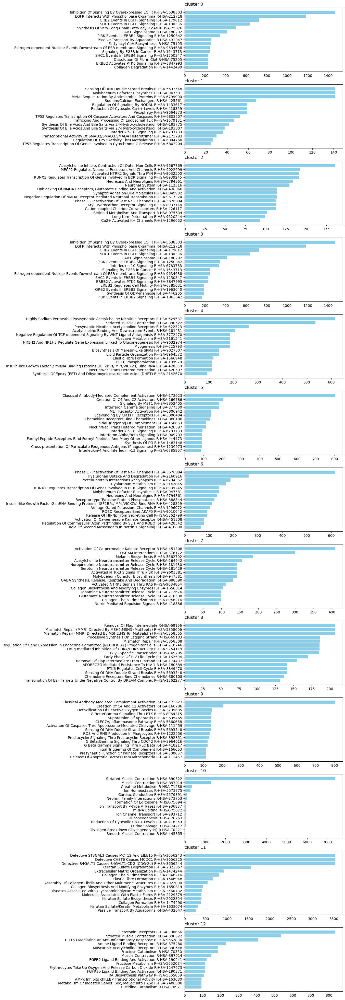

In [143]:
fig = plt.figure(figsize=(8, 50))
for i in range(13):
    ax = plt.subplot(13, 1, i+1)
    results = enrs[i].sort_values(by='Combined Score', ascending=False).head(15)  # Select top 10 results for visualization

    ax.barh(results['Term'], results['Combined Score'], color='skyblue')

    plt.title(f"cluster {i}", loc="left")
    plt.gca().invert_yaxis()  # Invert y-axis to have the highest score on top

/tmp/ipykernel_2419/2793648643.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cluster_counts = fdata.obs.groupby(["time_point", "cluster_cellcharter_autok"]).size().unstack(fill_value=0)


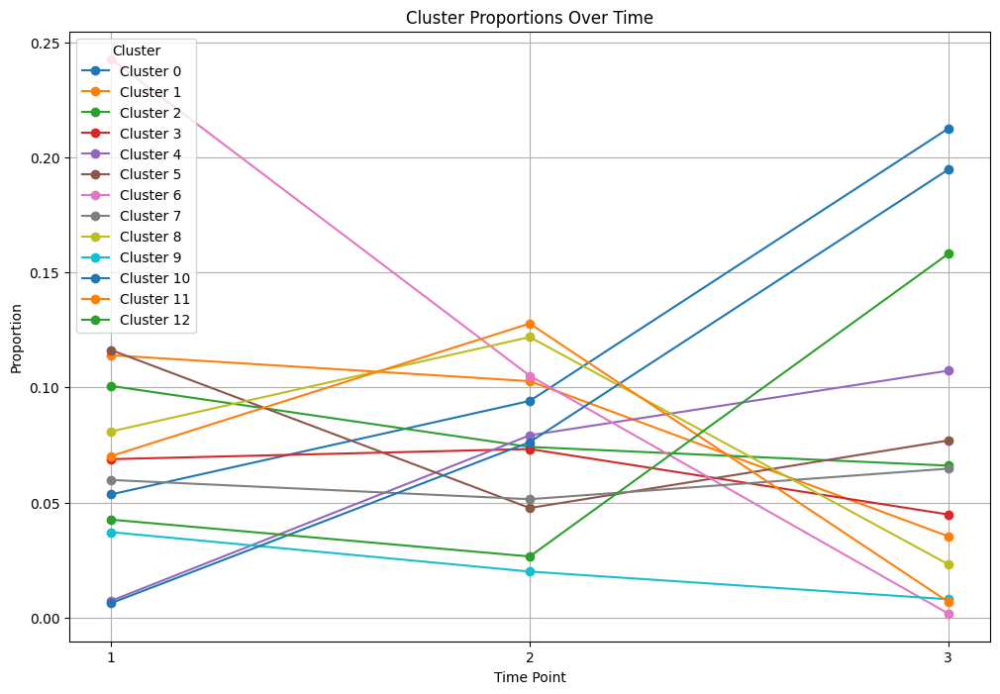

In [297]:
cluster_counts = fdata.obs.groupby(["time_point", "cluster_cellcharter_autok"]).size().unstack(fill_value=0)
cluster_proportions = cluster_counts.div(cluster_counts.sum(axis=1), axis=0)
cluster_proportions = cluster_proportions.reset_index()
long_df = cluster_proportions.melt(id_vars="time_point", var_name="cluster", value_name="proportion")

plt.figure(figsize=(12, 8))
for cluster in cluster_proportions.columns[1:]:
    subset = long_df[long_df["cluster"] == cluster]
    plt.plot(subset["time_point"], subset["proportion"], marker='o', label=f'Cluster {cluster}')
    
plt.xlabel("Time Point")
plt.ylabel("Proportion")
plt.title("Cluster Proportions Over Time")
plt.legend(title="Cluster")
plt.grid(True)
plt.show()

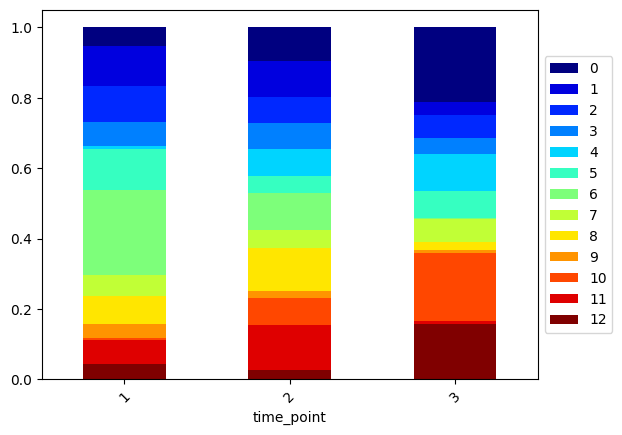

In [298]:
cc.pl.proportion(fdata, group_key="time_point", label_key="cluster_cellcharter_autok")

In [62]:
sc.pp.pca(fdata)

In [139]:
fdata.obs["cluster_cellcharter"] = [str(i) for i in fdata.obs["cluster_cellcharter_givenk"]]

In [90]:
fdata

AnnData object with n_obs × n_vars = 66509 × 17806
    obs: 'time_point', 'n_genes', 'n_counts', '_scvi_batch', '_scvi_labels', 'cluster_cellcharter', 'cluster_cellcharter_autok', 'cluster_cellcharter_givenk'
    var: 'mt', 'gm', 'Rb', 'mt-'
    uns: '_cellcharter', '_scvi_manager_uuid', '_scvi_uuid', 'cluster_cellcharter_autok_colors', 'cluster_cellcharter_colors', 'cluster_cellcharter_givenk_colors', 'log1p', 'rank_genes_groups', 'spatial_neighbors', 'pca', 'dendrogram_cluster_cellcharter_givenk', 'dendrogram_cluster_cellcharter_autok', 'dendrogram_cluster_cellcharter'
    obsm: 'X_cellcharter', 'X_scVI', 'spatial', 'X_pca'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'spatial_connectivities', 'spatial_distances'

In [140]:
fdata.obs["cluster_cellcharter"]

121947201_1    10
10921601_1      4
160170401_1     4
167450801_1     4
5462201_1       2
               ..
145335401_3    12
3472201_3      12
10801_3         4
1739301_3       4
1739201_3       4
Name: cluster_cellcharter, Length: 66509, dtype: object

In [277]:
fdata.uns["dendrogram_cluster_cellcharter"]["categories_ordered"]

['8', '3', '5', '12', '11', '0', '9', '6', '1', '2', '7', '4', '10']

In [278]:
sc.tl.rank_genes_groups(fdata, groupby="cluster_cellcharter", method="t-test")
sc.tl.dendrogram(fdata, groupby="cluster_cellcharter")

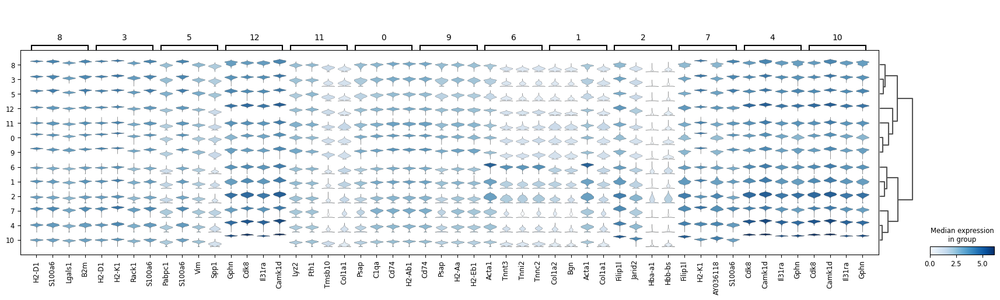

In [279]:
sc.pl.rank_genes_groups_stacked_violin(fdata, groupby="cluster_cellcharter", n_genes=4)

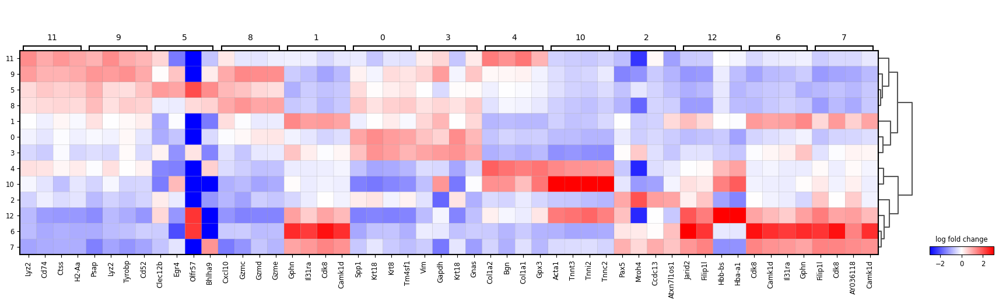

In [141]:
sc.pl.rank_genes_groups_matrixplot(fdata, groupby="cluster_cellcharter", n_genes=4, cmap="bwr", values_to_plot="logfoldchanges", vmin=-3, vmax=3, min_logfoldchange=1)

In [44]:
deg_matrix = fdata[:, deg].X.toarray()
deg_matrix.shape

(66510, 347)

In [34]:
fdata

AnnData object with n_obs × n_vars = 66509 × 17806
    obs: 'time_point', 'n_genes', 'n_counts', '_scvi_batch', '_scvi_labels', 'cluster_cellcharter', 'cluster_cellcharter_autok', 'cluster_cellcharter_givenk'
    var: 'mt', 'gm', 'Rb', 'mt-'
    uns: 'log1p', '_scvi_uuid', '_scvi_manager_uuid', 'spatial_neighbors', '_cellcharter', 'cluster_cellcharter_colors', 'rank_genes_groups', 'cluster_cellcharter_autok_colors', 'cluster_cellcharter_givenk_colors'
    obsm: 'spatial', 'X_scVI', 'X_cellcharter'
    layers: 'counts'
    obsp: 'spatial_connectivities', 'spatial_distances'

In [127]:
Tex = ['Havcr2', 'Lag3', 'Pdcd1', 'Entpd1', 'Tigit', 'Ctla4', 'Layn']
Macrophages = ["Ptprc", "Cd14", "Itgam", "Itgax", "Trem2", "Fcgr3a", "Fcgr3b", "Ccr2", "Cd163", "Cd68", "Arg1", "Adgre1", "Cd33", "Cd68", "C1qa", "Cd163",  "C1qb", "C1qc",  "Marco", "Cd81"]
DC = ["Ptprc", "Itgam", "Itgax", "Cd14", "Cd33", "Cd68", "Cd1c", "Cd209", "Ccl22", "Cd86", "Clec9a", "Clec10a", "Xcr1", "Lamp3"]
Endothelial = ["Vwf", "Pecam1", "Cldn5","Cdh5", "Mgp"]
Fibroblasts = ["Col1a1", "Col1a2", "Col3a1","Mmp2", "Myl9", "Dcn","Fap"]
NK = ["Ptprc", "Klrd1", "Mrpl47", "Ncr1", "NkG7", "Gnly", "Klrk1", "Klrc1", "Gzmb", "Klrf1"]
T = ["Ptprc", "Cd3d", "Cd3g", "Cd3e", "Cd8a", "Cd4", "Trbc1","Trbc2","Trac","Gnly", "Klrg1", "Gzmb", "Prf1", "Gzmk", "Ccr7", "Il7r", "Sell", "Lef1", "Tcf7", "Lag3", "Layn", "Havcr2", "Ctla4", "Ggt1", "Tigit", "Cd160", "Tox", "Prdm1", "Socs1", "Eomes", "Tbx21", "Batf", "Foxo1", "Cd4", "Foxp3", "Gata3", "Tbx21", "Cxcr3", "Cd8b"]
B = ["Ptprc", "Cd19", "Tnfrsf17", "Cd79a", "Cd79b", "Slamf7", "Igkc", "Ms4a1"]
Plasma = ["Cd79a", "Mzb1", "Jchain", "Igha1", "Ighg1", "Mki67"]
Neutrophils = ["Ptprc", "S100a9", "Mpo", "Cxcr2", "Csf3r", "Aqp9"]
Malignant = ["Mki67", "Epcam", "Top2a", "Ascl2", "Cbx3", "Hsp90ab1", "Zfas1", "Pabpc1", "Gtf3a", "Nap1l1", "Tgfbi", "Ifitm3", "Hspd1", "Nono", "Hsph1", "Nkd1", "Ly6e", "C6orf48", "Ssb", "Rsl1d1", "Dpep1", "Dkc1", "Bmp4", "Gng4", "Cpne1", "Zdhhc9", "Dars", "Scd", "Myc", "Phlda1", "Dach1", "Cldn1", "Krt23"]
MAST = ["Tpsab1", "Kit"]
Epithelial = ["Cdh1", "Epcam", "Cdkn2a", "Krt5", "Krt17", "Muc5b"]
Hepatocytes = ["Alb","Apoa1","Afp","Tf","Apom","Asgr1","Pck1","Ass1", "Hamp", "Pck1", "Ttrdefb1"]
SmoothMuscle = ["Acta2", "My19", "Myh11", "Mylk","Tagln","Mcam","Actg2","Mgp","Des","Tmp1"]

hallmark_file = open("./GO/mh.all.v2023.2.Mm.symbols.gmt", 'r')
data = []
for line in hallmark_file:
    parts = line.strip().split('\t')
    hallmark = parts[0]
    genes = parts[2:]

    for gene in genes:
        data.append([hallmark, gene])

hallmark_df = pd.DataFrame(data, columns=['Hallmark', 'Gene'])
hallmark_df['Hallmark'] = [mark.lstrip('HALLMARK')[1:].lower() for mark in hallmark_df['Hallmark']]
hallmarks = np.unique(hallmark_df['Hallmark'])

In [264]:
celltypes = {}
celltypes["macrophages"] = Macrophages
celltypes["DC"] = DC
celltypes["Endothelial"] = Endothelial
celltypes["Fibroblasts"] = Fibroblasts
celltypes["NK"] = NK
celltypes["T"] = T
celltypes["B"] = B
celltypes["Plasma"] = Plasma
celltypes["Neutrophils"] = Neutrophils
celltypes["Malignant"] = Malignant
celltypes["MAST"] = MAST
celltypes["Epithelial"] = Epithelial
celltypes["Hepatocytes"] = Hepatocytes
celltypes["SmoothMuscle"] = SmoothMuscle

In [129]:
marks = {}
for interest in hallmarks:
    pathway = hallmark_df.loc[hallmark_df['Hallmark'] == f"{interest}", 'Gene']
    d = [gene for gene in deg if np.sum(np.isin(pathway, gene))]
    marks[interest] = d
    # if len(d) > 0: print(interest, d)
marks["t_exhaustion"] = [gene for gene in deg if np.sum(np.isin(Tex, gene))]
marks["macrophages"] = [gene for gene in deg if np.sum(np.isin(Macrophages, gene))]
marks["fibroblasts"] = [gene for gene in deg if np.sum(np.isin(Fibroblasts, gene))]
marks["dentritic"] = [gene for gene in deg if np.sum(np.isin(DC, gene))]
marks["endothelial"] = [gene for gene in deg if np.sum(np.isin(Endothelial, gene))]
marks["natural_killing"] = [gene for gene in deg if np.sum(np.isin(NK, gene))]
marks["t"] = [gene for gene in deg if np.sum(np.isin(T, gene))]
marks["b"] = [gene for gene in deg if np.sum(np.isin(B, gene))]
marks["maglinant"] = [gene for gene in deg if np.sum(np.isin(Malignant, gene))]
marks["plasma"] = [gene for gene in deg if np.sum(np.isin(Plasma, gene))]
marks["neutrophils"] = [gene for gene in deg if np.sum(np.isin(Neutrophils, gene))]
marks["mast"] = [gene for gene in deg if np.sum(np.isin(MAST, gene))]
marks["epithelial"] = [gene for gene in deg if np.sum(np.isin(Epithelial, gene))]
marks["hepatocytes"] = [gene for gene in deg if np.sum(np.isin(Hepatocytes, gene))]
marks["smooth_muscle"] = [gene for gene in deg if np.sum(np.isin(SmoothMuscle, gene))]
for path, genes in marks.items():
   if len(genes) > 0:
       print(path, genes)
       sc.tl.score_genes(fdata, gene_list=genes, score_name=f"{path}_score")
#       sq.pl.spatial_scatter(hdata, color=[f"{path}_score"], size=10, shape=None, library_id="gRNA")

adipogenesis ['Adipoq', 'Retn', 'Lpl', 'Gphn', 'Cox8a']
allograft_rejection ['Il6', 'Gzma', 'Prf1', 'Ncr1', 'Il2ra', 'Cxcl9', 'Il2rb', 'Ifng', 'Gzmb', 'Ccl5']
androgen_response ['Krt19']
angiogenesis ['Lpl']
apical_junction ['Acta1', 'Nrap', 'Actn3', 'Adamts5', 'Cadm3', 'Cdk8', 'Cdh4']
apical_surface ['Slc2a4', 'Il2rb', 'Scube1']
apoptosis ['Krt18', 'Il6', 'Prf1', 'Cd44', 'Il1a']
cholesterol_homeostasis ['Lpl', 'Fabp5']
coagulation ['Serpinb2', 'Mmp10', 'Comp', 'A2m']
complement ['Serpinb2', 'Il6', 'Gzma', 'Gzmb', 'Ccl5', 'Fcer1g']
epithelial_mesenchymal_transition ['Areg', 'Pcolce2', 'Comp', 'Ptx3', 'Abi3bp', 'Il6', 'Col11a1', 'Cd44', 'Grem1', 'Lrrc15']
estrogen_response_early ['Areg', 'Aqp3', 'Krt19', 'Krt18', 'Cd44']
estrogen_response_late ['Areg', 'Krt19', 'Perp', 'Cd44', 'Fabp5', 'Ass1']
fatty_acid_metabolism ['Eno3']
glycolysis ['Pgam2', 'Cd44']
heme_metabolism ['Aqp3', 'Acsl6', 'Alas2', 'Snca']
hypoxia ['Pgam2', 'Eno3', 'Il6']
il2_stat5_signaling ['Eno3', 'Cxcl10', 'Il2ra', 'Il2

In [135]:
cluster_score = {}
for cel, genes in marks.items():
   if len(genes) > 0:
       cluster_means = fdata.obs.groupby("cluster_cellcharter_givenk")[f"{path}_score"].mean()
       cluster_score[path] = cluster_means
cluster_score = pd.DataFrame(cluster_score)

/tmp/ipykernel_2419/3860892295.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cluster_means = fdata.obs.groupby("cluster_cellcharter_givenk")[f"{path}_score"].mean()


In [133]:
import seaborn as sns

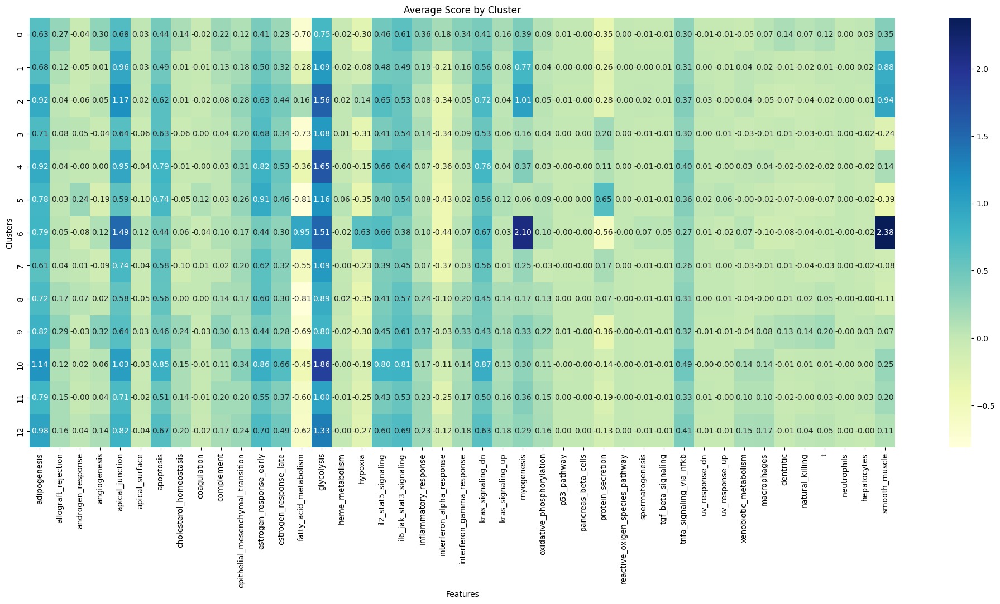

In [139]:
plt.figure(figsize=(25, 10))
sns.heatmap(cluster_score, annot=True, fmt=".2f", cmap="YlGnBu")
plt.title('Average Score by Cluster')
plt.xlabel('Features')
plt.ylabel('Clusters')
plt.show()

In [141]:
fdata.write_h5ad("./RNA/Multitime.clustered.go.h5")

In [266]:
for celltype, genes in celltypes.items():
    print(celltype)
    sc.tl.score_genes(fdata, gene_list=genes, score_name=f"{celltype}_type")

macrophages
DC
Endothelial
Fibroblasts
NK
T
B
Plasma
Neutrophils
Malignant
       'Dars', 'Scd'],
      dtype='object')
MAST
Epithelial
Hepatocytes
SmoothMuscle


/tmp/ipykernel_2419/3319561663.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cluster_means = fdata.obs.groupby("cluster_cellcharter_givenk")[f"{celltype}_type"].mean()


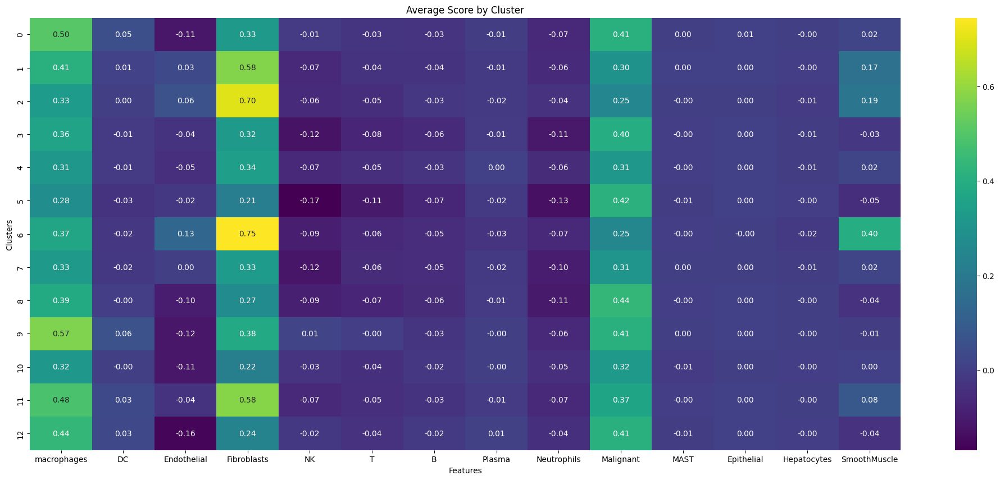

In [270]:
cluster_score = {}
for celltype, genes in celltypes.items():
    cluster_means = fdata.obs.groupby("cluster_cellcharter_givenk")[f"{celltype}_type"].mean()
    cluster_score[celltype] = cluster_means

cluster_score = pd.DataFrame(cluster_score)

plt.figure(figsize=(25, 10))
sns.heatmap(cluster_score, annot=True, fmt=".2f", cmap="viridis")
plt.title('Average Score by Cluster')
plt.xlabel('Features')
plt.ylabel('Clusters')
plt.show()

In [271]:
fdata.write_h5ad("./RNA/Multitime.clustered.go.h5")